In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

from superpoint.settings import EXPER_PATH
import superpoint.evaluations.descriptor_evaluation as ev
from utils import plot_imgs
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
def draw_matches(data):
    keypoints1 = [cv2.KeyPoint(p[1], p[0], 1) for p in data['keypoints1']]
    keypoints2 = [cv2.KeyPoint(p[1], p[0], 1) for p in data['keypoints2']]
    inliers = data['inliers'].astype(bool)
    if np.any(inliers):
        matches = np.array(data['matches'])[inliers].tolist()
    else:
        matches = []
    
    img1_bw = np.uint8(output['image1'])
    img2_bw = np.uint8(output['image2'])
    
    img1 = np.concatenate([img1_bw, img1_bw, img1_bw], axis=2)
    img2 = np.concatenate([img2_bw, img2_bw, img2_bw], axis=2)

    return cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches,
                           None, matchColor=(0,255,0), singlePointColor=(0, 0, 255))

# Changes in viewpoint

In [3]:
experiments = ['chain_coco_subset/sp_descriptors'] #'superpoint_coco_joint_coco_patches'] # this is also with low threshold

### Images visualization

Matches found: 31
Matches found: 57
Matches found: 44
Matches found: 46
Matches found: 31


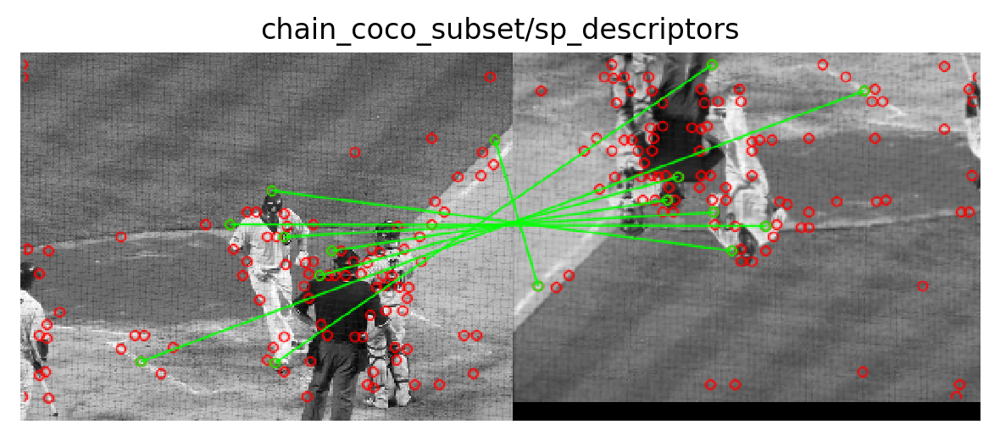

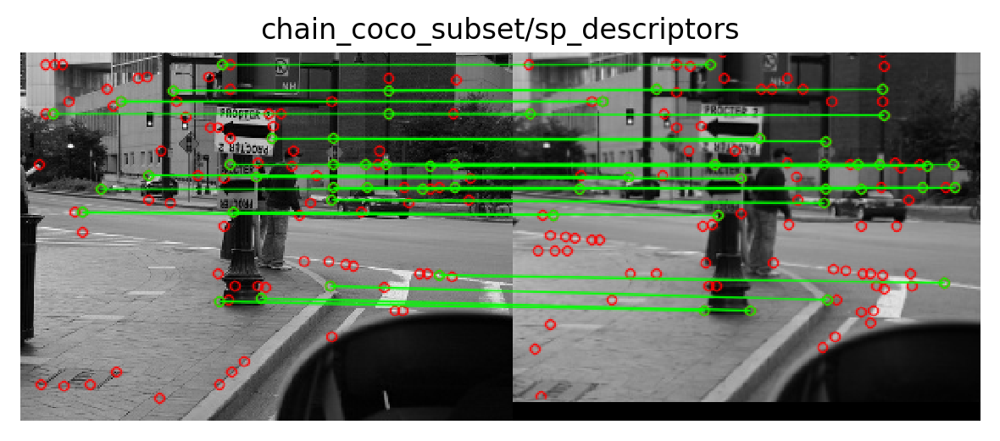

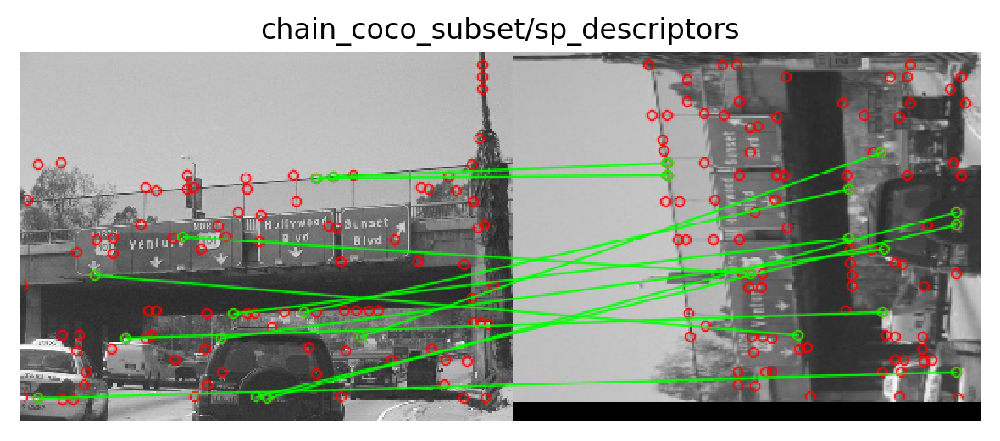

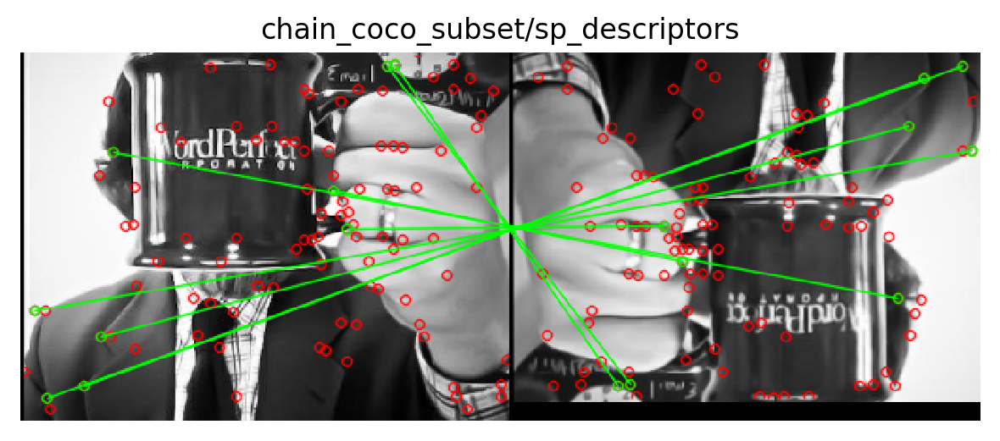

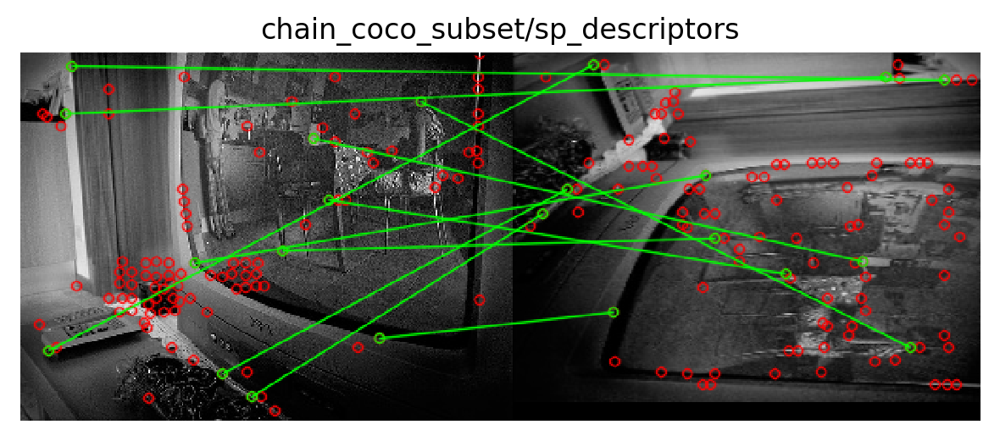

In [4]:
num_images = 5
for e in experiments:
    orb = True if e[:3] == 'orb' else False
    outputs = ev.get_homography_matches(e, keep_k_points=100, correctness_thresh=3, num_images=num_images, orb=orb)
    for output in outputs:
        img = draw_matches(output) / 255.
        plot_imgs([img], titles=[e], dpi=200)

### Homography estimation correctness

In [5]:
for exp in experiments:
    orb = True if exp[:3] == 'orb' else False
    correctness = ev.homography_estimation(exp, keep_k_points=1000, correctness_thresh=5, orb=orb)
    print('> {}: {}'.format(exp, correctness))

Matches found: 239
Matches found: 530
Matches found: 346
Matches found: 262
Matches found: 311
Matches found: 601
Matches found: 343
Matches found: 265
Matches found: 235
Matches found: 247
Matches found: 245
Matches found: 243
Matches found: 567
Matches found: 515
Matches found: 596
Matches found: 275
Matches found: 241
Matches found: 278
Matches found: 312
Matches found: 662
Matches found: 293
Matches found: 542
Matches found: 337
Matches found: 661
Matches found: 533
Matches found: 297
Matches found: 371
Matches found: 358
Matches found: 282
Matches found: 653
Matches found: 617
Matches found: 535
Matches found: 299
Matches found: 355
Matches found: 233
Matches found: 354
Matches found: 251
Matches found: 307
Matches found: 475
Matches found: 389
Matches found: 325
Matches found: 324
Matches found: 233
Matches found: 254
Matches found: 465
Matches found: 211
Matches found: 534
Matches found: 501
Matches found: 560
Matches found: 350
Matches found: 662
Matches found: 538
Matches foun

KeyError: 'homography is not a file in the archive'

### Check that the image is warped correctly

Matches found: 98
Matches found: 176
Matches found: 335
Matches found: 376
Matches found: 283
Matches found: 361
Matches found: 302
Matches found: 653
Matches found: 339
Matches found: 97
Matches found: 419
Matches found: 435
Matches found: 286
Matches found: 388
Matches found: 332
Matches found: 235
Matches found: 523
Matches found: 524
Matches found: 423
Matches found: 592
Matches found: 224
Matches found: 277
Matches found: 438
Matches found: 495
Matches found: 274
Matches found: 458
Matches found: 389
Matches found: 440
Matches found: 511
Matches found: 231
Matches found: 83
Matches found: 301
Matches found: 152
Matches found: 495
Matches found: 738
Matches found: 386
Matches found: 124
Matches found: 128
Matches found: 219
Matches found: 489
Matches found: 252
Matches found: 237
Matches found: 537


/cluster/apps/python/3.6.4/lib64/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


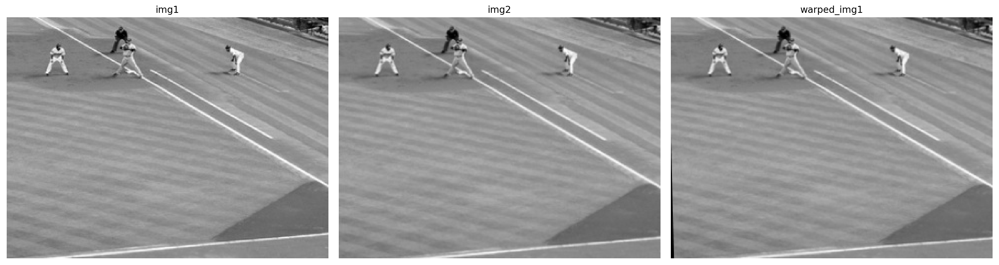

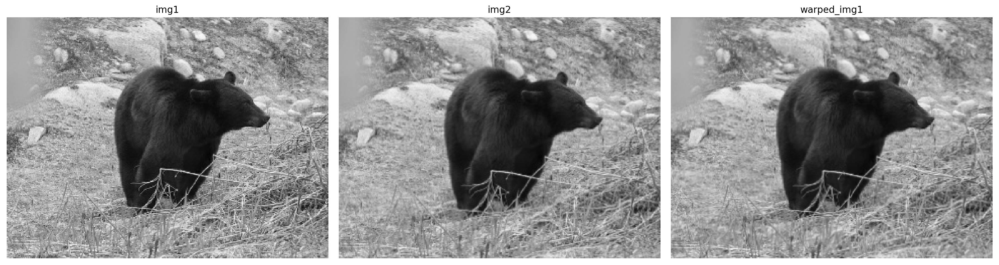

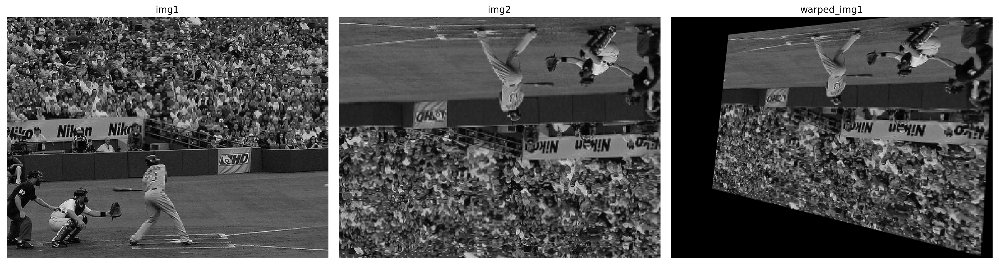

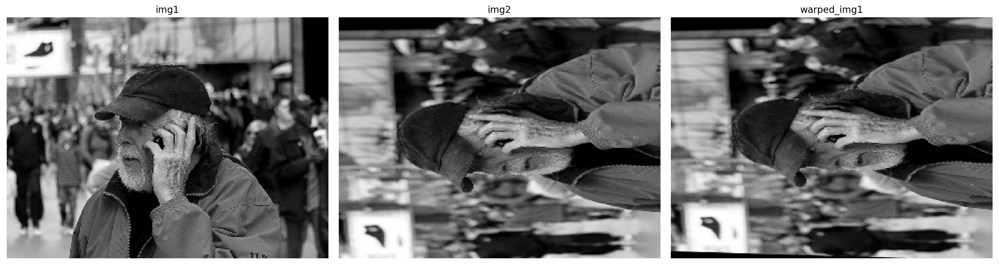

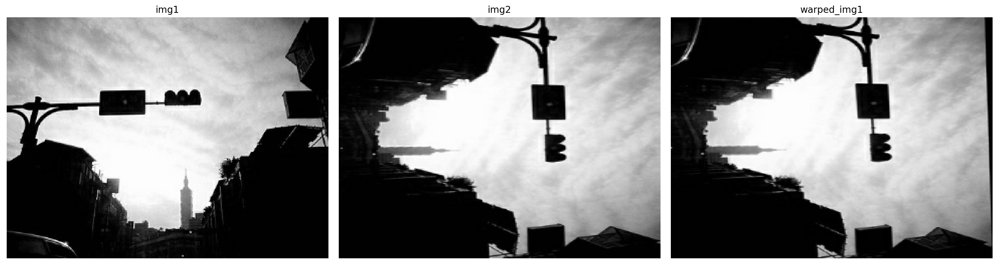

...

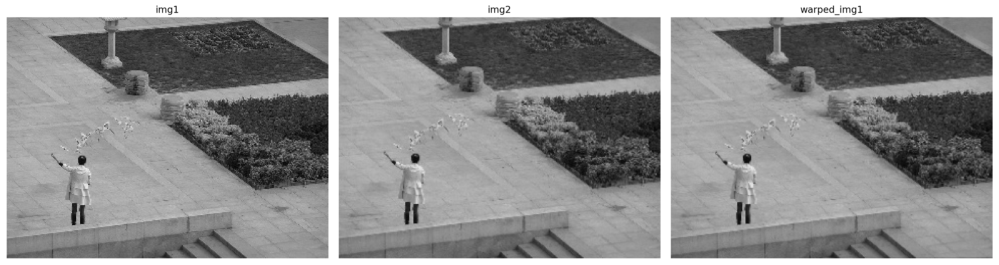

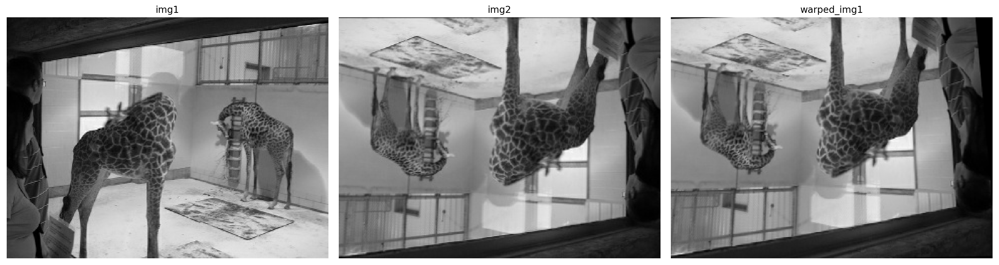

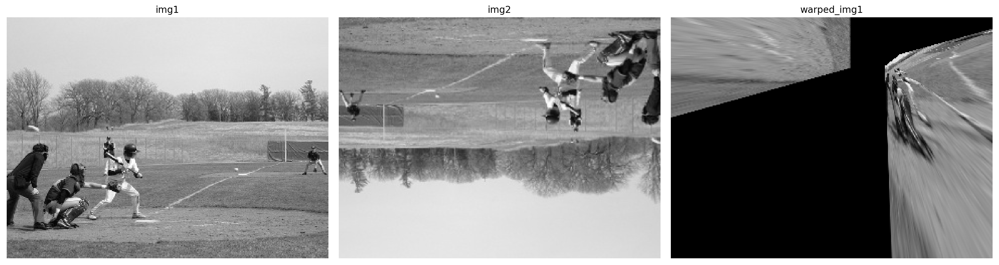

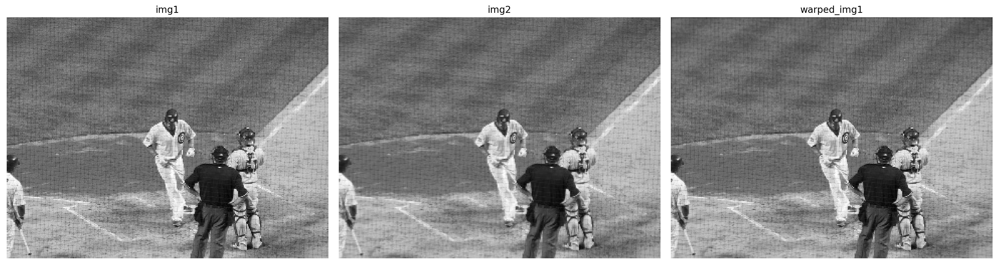

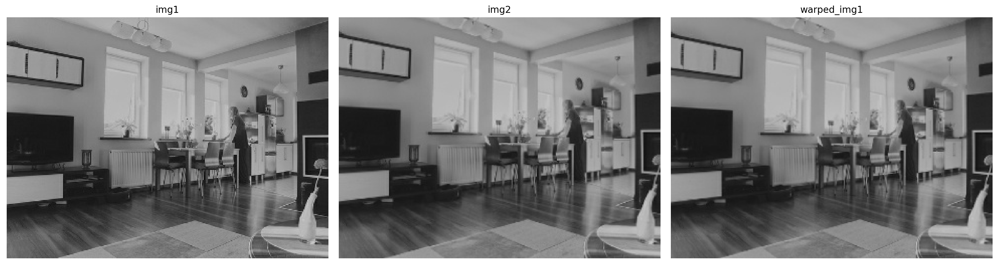

In [6]:
num_images = 50
for e in experiments:
    orb = True if e[:3] == 'orb' else False
    outputs = ev.get_homography_matches(e, keep_k_points=1000, correctness_thresh=3, num_images=num_images, orb=orb)
    for output in outputs:
        img1 = output['image1']
        img2 = output['image2']
        H = output['homography']
        if np.any(H):
            warped_img1 = cv2.warpPerspective(img1, H, (img2.shape[1], img2.shape[0]))
            img1 = np.concatenate([img1, img1, img1], axis=2)
            warped_img1 = np.stack([warped_img1, warped_img1, warped_img1], axis=2)
            img2 = np.concatenate([img2, img2, img2], axis=2)
            plot_imgs([img1 / 255., img2 / 255., warped_img1 / 255.], titles=['img1', 'img2', 'warped_img1'], dpi=200)